In [3]:
from PIL import Image
from PIL import ImageChops, ImageOps, ImageDraw
import glob
import numpy as np
import tqdm

In [5]:
files = glob.glob('photos-scene/output*.png')
ref_fn = 'photos-scene/ref.png'


In [6]:
im1 = Image.open(files[2])
im2 = Image.open(files[3])
ref = Image.open(ref_fn).convert("RGB")

In [7]:
diff = ImageChops.difference(im1, ref)


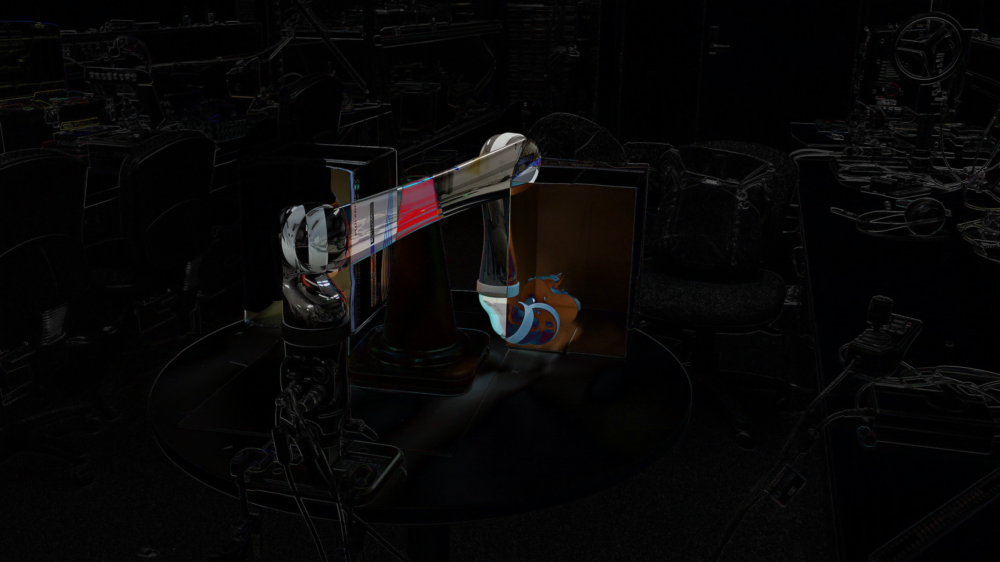

In [8]:
diff

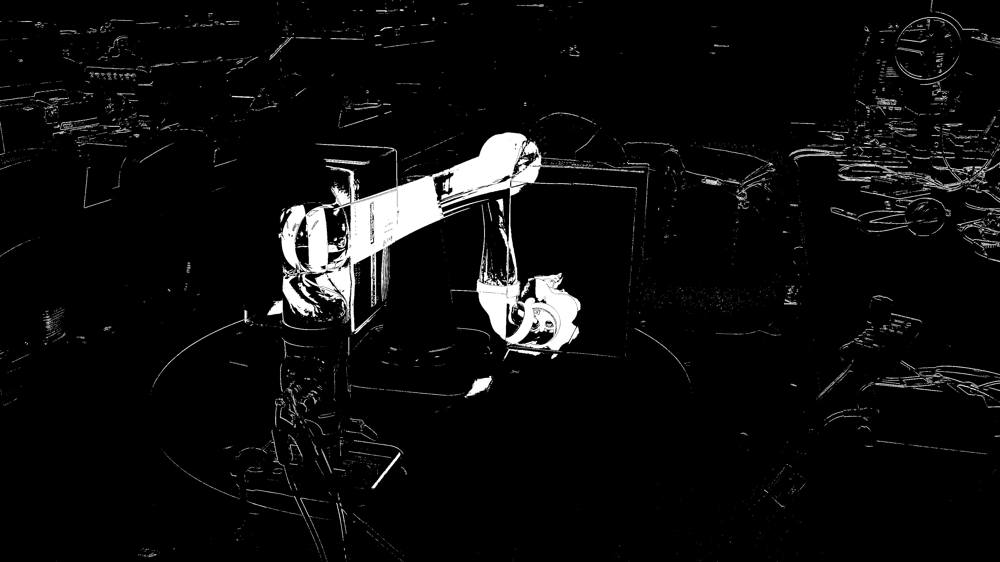

In [9]:
def get_diff_mask(im, ref, norm_diff=60, mask_vals=255, asarray=True):
    diff = ImageChops.difference(im, ref)
    norm = np.linalg.norm(np.array(diff), axis=2)
    mask = norm > norm_diff
    if not asarray:
        mask = Image.fromarray((mask*mask_vals).astype(np.uint8))
    return Image.fromarray(mask)

def get_alpha_image(im, ref, norm_diff=20):
    mask = get_diff_mask(im, ref, norm_diff=norm_diff)
    im_alpha = im.copy()
    im_alpha.putalpha(mask)
    return im_alpha

def remove_unwanted_color(image, color=[212, 20, 0], threshold=30):
    close_to_unwanted_color = np.linalg.norm(np.array(image) - np.array(color), axis=2) < threshold

    image = image.copy()
    image_data = image.load()
    height,width = image.size
    alpha = np.ones(image.size).astype(np.uint8) * 255
    for loop1 in range(height):
        for loop2 in range(width):
            if close_to_unwanted_color[loop2, loop1]:
                r,g,b = image_data[loop1,loop2]
                image_data[loop1,loop2] = 0,0,0
                alpha[loop1, loop2] = 0
    return image, alpha

mask = get_diff_mask(im1, ref)
mask

100%|███████████████████████████████████████████████████████████████████████████████████| 31/31 [01:20<00:00,  2.61s/it]


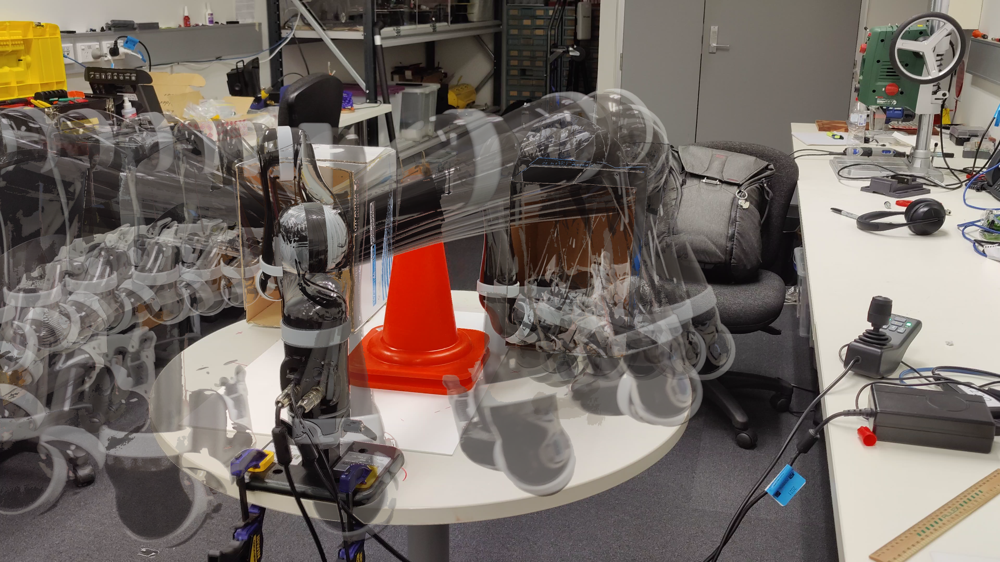

In [10]:
#def alpha
_files = files[:]
main_img = ref.copy()

main_img = Image.open(files[0])

#main_img.paste(Image.open('output_0006.png'), (0,0), get_diff_mask(Image.open('output_0006.png'), ref, 20))

for fn in tqdm.tqdm(_files):    
    im = Image.open(fn)
    __img, alpha = remove_unwanted_color(im, threshold=150)
    
    diff_mask = get_diff_mask(im, ref, 70, asarray=True)
    final_mask = np.logical_and((alpha == 255).T, diff_mask)
    
    main_img.paste(im, (0, 0), Image.fromarray((final_mask*140).astype(np.uint8)))
#     break


#main_img.paste(Image.open('output_0029.png'), (0,0), get_diff_mask(Image.open('output_0029.png'), ref, 20))
    
main_img